# Efecto Walkie-Talkie a partir de filtros FIR e IIR

Ana Cristina Henao Guerra cc.1037670380

# Definición de Librerías

In [40]:
from scipy.io.wavfile import read  #libreria para la lectura de audios
from IPython.display import Audio  #para escuchar la señal
import matplotlib.pyplot as plt
import numpy as np
from scipy.fft import fft, fftfreq
import scipy.signal as sp
from scipy.signal import kaiserord, lfilter, firwin, freqz
import scipy.signal as signal
import matplotlib.cm as cm
from scipy.fft import fft, fftshift

# 1. Extraccion De Señales de audio

1.1 En esta primera sección usted deberá cargar las dos señales de audio de la carpeta proporcionada, la cual contiene un audio y una copia del mismo con efecto walkie-talkie. Este ultimo es un referente al cual se tiene que llegar.

Las señales son suministradas con el fin de mostrar el efecto al cual se debe llegar, es importante que en el código incluya la opción de escucharlas.

Para esto deberá hacer uso de las librerías scipy.io.wavfile, IPython.display, matplotlib.pyplot y numpy; con el fin de extraer, normalizar y graficar las señales mencionadas. Así mismo, se debe poder reproducir cada uno de ellas.

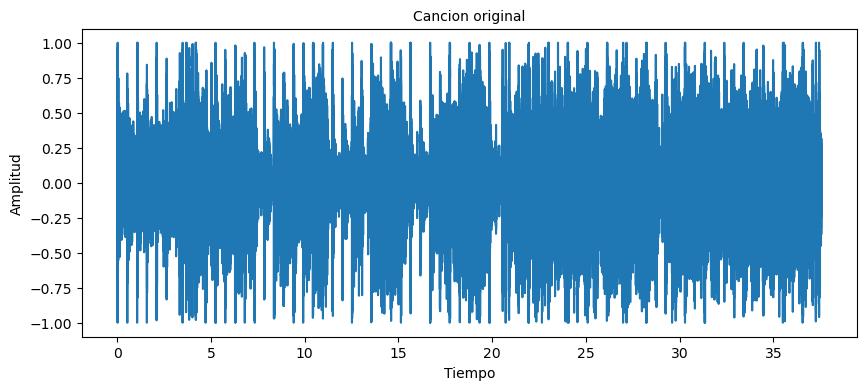

Cancion Original


In [41]:
#cancion original
file_audio=('Que tengas suertecita(Original).wav') #Ruta del archivo con la señal
fs, x=read(file_audio)  #Cargar el archivo

X1=x[:,0]
x1=X1/float(max(abs(X1)))  #Escala de amplitud de la señal
t=np.arange(0,float(len(x1))/fs, 1/fs)  #vector de tiempo
x1=x1-np.mean(x1)
plt.figure(figsize=(10,4))

plt.plot(t,x1)  #graficacion
plt.xlabel('Tiempo',fontsize=10)
plt.ylabel('Amplitud',fontsize=10)
plt.title('Cancion original',fontsize=10)

plt.show()

print('Cancion Original')
Audio(x1,rate=fs)  #para escuchar la señal si se desea

C:\Users\Usuario\AppData\Local\Temp\ipykernel_4024\3256019515.py:3: WavFileWarning: Chunk (non-data) not understood, skipping it.
  fs2, y=read(file_audio2)  #Cargar el archivo


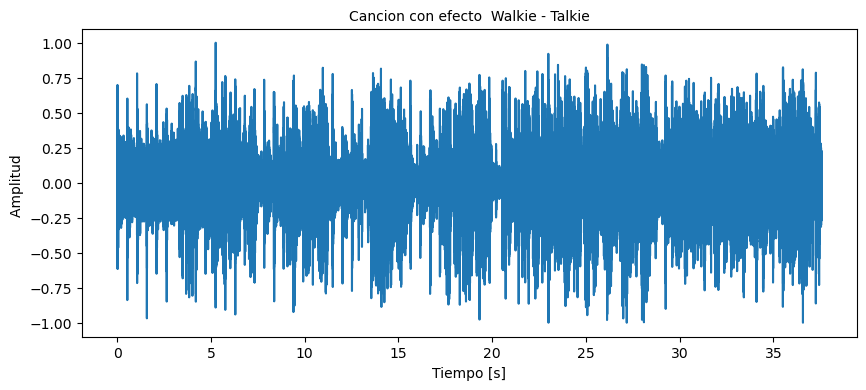

Cancion con efecto Walkie - Talkie


In [59]:
#cancion con efecto Walkie - Talkie
file_audio2=('Que tengas suertecita(Walkie-Talkie).wav') #Ruta del archivo con la señal
fs2, y=read(file_audio2)  #Cargar el archivo

X2=y[:,0]
x2=X2/float(max(abs(X2)))  #Escala de amplitud de la señal
t2=np.arange(0,float(len(x2))/fs2, 1/fs2)  #vector de tiempo
x2=x2-np.mean(x2)
plt.figure(figsize=(10,4))

plt.plot(t2,x2)  #graficacion
plt.xlabel('Tiempo [s]',fontsize=10)
plt.ylabel('Amplitud ',fontsize=10)
plt.title('Cancion con efecto  Walkie - Talkie',fontsize=10)
plt.show()

print('Cancion con efecto Walkie - Talkie')
Audio(x2,rate=fs2)  #para escuchar la señal si se desea

Responda: 
¿Que cambios visuales puede notar en la señal?

Visualmente se observa que hay una disminucion del nivel de la señal y la concentracion de valores en ciertas regiones también se hace menor.

1.2 Ahora, usted deberá calcular y comparar la potencia de la señal original y con efecto.

In [43]:
N = len(x1)
Pot=(1/N)*(np.sum(x1**2))
Pot_efecto=(1/N)*(np.sum(x2**2))

print('potencia de la señal Original: '+str(Pot))   
print('potencia de la señal con efecto: '+str(Pot_efecto))  

potencia de la señal Original: 0.052139312312034995
potencia de la señal con efecto: 0.03093924914719744


Responda:

¿Existen cambios en la potencia de la señal? si es así, explique el por qué.

Si hay cambio en la potencia de las señales ya que al aplicar el efecto, se pasa la señal por un filtro y esto lo que hace es eliminar ciertas componentes frecuenciales que restan potencia a la señal con efecto, con respecto a la original (sin efecto).

# 2. Aplicación FFT a las señales original y con efecto walkie-talkie.

En esta sección usted deberá analizar frecuencialmente las señales e identificar los cambios que se presentan en la señal con efecto.

2.1. Análisis frecuencial con FFT: Usted deberá realizar el proceso de transformada rápida de fourier y graficar la respuesta de la misma.

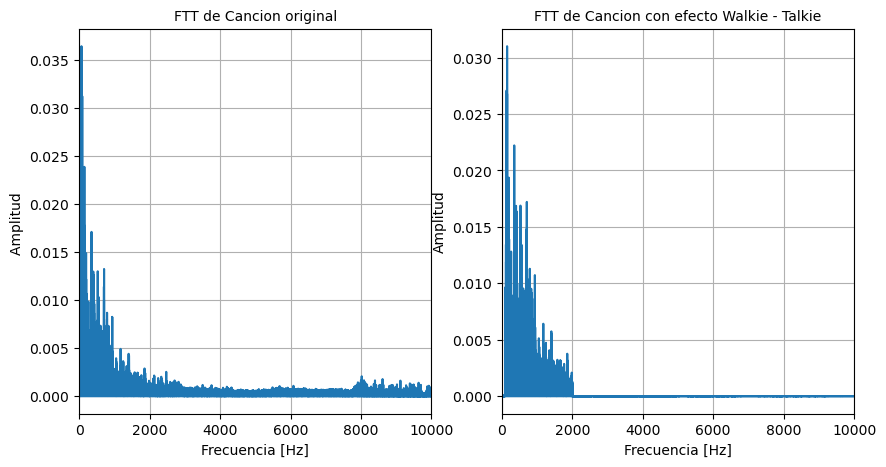

In [44]:
fft_1 = fft(x1)#fft de la cancion original 
xf = fftfreq(fft_1.size, 1/fs) 

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.plot(xf, abs(fft_1)/np.linalg.norm(fft_1))
plt.xlim(0,10000)
plt.xlabel('Frecuencia [Hz]',fontsize=10)
plt.ylabel('Amplitud ',fontsize=10)
plt.title('FTT de Cancion original',fontsize=10)
plt.grid()


fft_2 = fft(x2)#fft de la cancion con efecto walkie-talkie 
xf = fftfreq(fft_2.size, 1/fs2) 

plt.subplot(1,2,2)
plt.plot(xf, abs(fft_2)/np.linalg.norm(fft_2))
plt.xlim(0,10000)
plt.xlabel('Frecuencia [Hz]',fontsize=10)
plt.ylabel('Amplitud',fontsize=10)
plt.title('FTT de Cancion con efecto Walkie - Talkie',fontsize=10)
plt.grid()

plt.show()

Responda: 
¿Qué puede identificar entre las transformadas?
¿Por qué cree que sucede esto?

Entre las tranformadas, se puede notar que se aplicó un filtro pasa-bajas con una frecuencia de corte cercana a los 2kHz. Posiblemente, tambien hay un filtro pasa altas con una frecuencia de corte muy baja, que hace que disminuya el nivel de amplitud de algunas frecuencias cercanas a cero.

2.2. Realice el calculo de correlación entre estas dos señales.

In [45]:
xcorr=np.corrcoef(x1,x2)
print(f'Coeficiente de correlación: {xcorr}')

Coeficiente de correlación: [[1.         0.78044241]
 [0.78044241 1.        ]]


Responda:
   
¿Qué se puede concluir del valor del coeficiente obtenido? 

Se puede concluir que no se ha aplicado ningun otro tipo de proceso diferente al filtrado pasa-bajas y posible pasa-altas, ya que la señal es la misma, pues tiene al rededor de un 70% de similitud, el porcentaje restante haría referencia a las frecuencias filtradas con el efecto aplicado.

# 3.Análisis con Espectrograma

En esta sección usted deberá implementar la visualización de un espectrograma para analizar la señal original y con efecto.

## Funciones a utilizar

In [46]:
def extraer_ventanas(signal, size, fs):
    #Tamano de paso
    step=int(0.010*fs)
    n_seg = int((len(signal) - size) / step)
    # extraer segmentos
    windows = [signal[i * step : i * step + size]
        for i in range(n_seg)]
    # stack (cada fila es una ventana)
    return np.vstack(windows)

def potspec(X, size, n_padded_min=0):
    # Zero padding para la proxima potencia de 2
    if n_padded_min==0:
        n_padded = max(n_padded_min, int(2 ** np.ceil(np.log(size) / np.log(2))))
    else:
        n_padded = n_padded_min
        # Transformada de Fourier
        Y = np.fft.fft(X, n=n_padded)
        Y = np.absolute(Y)
        # non-redundant part
        m = int(n_padded / 2) + 1
        Y = Y[:, :m]
    return np.abs(Y) ** 2, n_padded

## 3.1 Aplicacion de ventana para espectrograma

Usted debe hacer uso de las funciones anteriores para definir un tipo de ventana que permita la visualización correcta de la información frecuencial de las señales. 

In [47]:
size=0.050
#Espectrograma de cancion original
ventanas=extraer_ventanas(x1,int(size*fs),fs)
window=np.blackman(len(ventanas[0]))
v_blackmanOriginal=window*ventanas

#Espectrograma de cancion procesada
ventanas=extraer_ventanas(x2,int(size*fs2),fs2)
window=np.blackman(len(ventanas[0]))
v_blackmanEfecto=window*ventanas


nota: escoja una ventana apropiada y explique por qué.

Se escogió la ventana blackman porque tiene un mayor ancho del lobulo principal, esto nos ayuda a mantener una fidelidad con respecto a la amplitud de la señal, y al mismo tiempo posee un primer lobulo lateral bastante atenuado, lo cual nos ayuda a visualizar mejor la diferencia en el filtrado (mayor resolucion entre la energia de interés).

## 3.2 Aplicacion de Espectrograma 

A continuación, haga uso de las funciones potspec, flipud de numpy y matplotlib para realizar la visualización del espectrograma

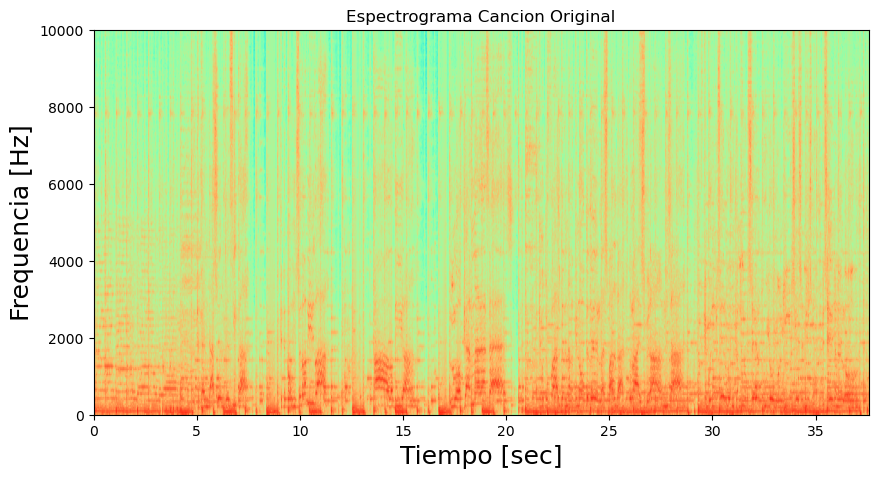

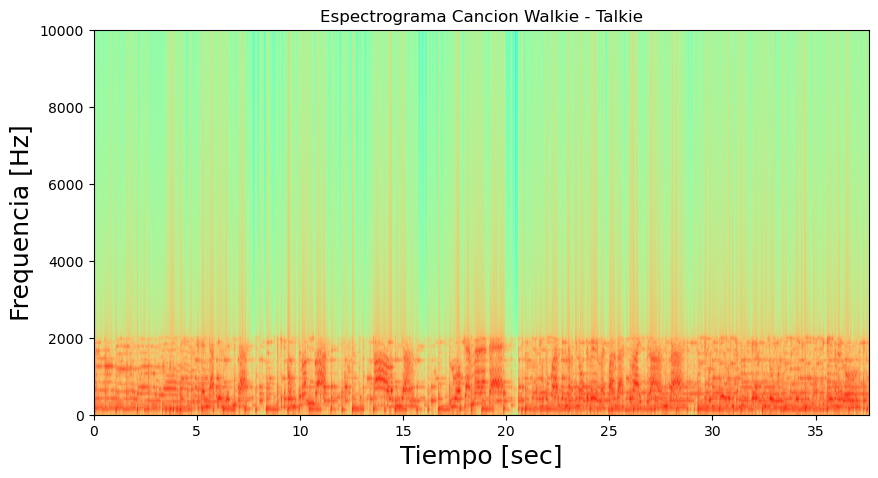

In [63]:
espectroO,nfft=potspec(v_blackmanOriginal,int(0.050*fs),1024)
espectro=np.flipud(10*np.log10(espectroO).T)

plt.figure(figsize=(10,5))
plt.title('Espectrograma Cancion Original')
plt.imshow(espectro,aspect='auto', cmap="rainbow", extent=[0, len(x1)/fs, 0, fs//2])
plt.ylim(0,10000)
plt.ylabel('Frequencia [Hz]', fontsize=18)
plt.xlabel('Tiempo [sec]', fontsize=18)
plt.show()

espectroE,nfft=potspec(v_blackmanEfecto,int(0.050*fs2),1024)
espectro=np.flipud(10*np.log10(espectroE).T)

plt.figure(figsize=(10,5))
plt.title('Espectrograma Cancion Walkie - Talkie')
plt.imshow(espectro,aspect='auto',cmap="rainbow", extent=[0, len(x2)/fs2, 0, fs2//2])
plt.ylim(0,10000)
plt.ylabel('Frequencia [Hz]', fontsize=18)
plt.xlabel('Tiempo [sec]', fontsize=18)
plt.show()


Responda:
 ¿Qué diferencias encuentra entre los espectrogramas?
 ¿Corresponde la gráfica de la transformada de fourier con lo obtenido en el espectrograma? ¿Por qué?
 ¿Que puede concluir a cerca de la señal con efecto?
 
La diferencia encontrada entre los espectogramas, es que la señal original posee mas energia en frecuencias superiores a los 2kHz, se visualiza claramente la frecuencia de corte del filtro usado en el efecto. Se visualiza también de forma muy sutil un pasa altas, por lo cual se puede conlcuir que las graficas de la fft y del espectrograma coinciden y en ambas señales se puede notar que el filtro es aplicado a toda la señal y no hay otros tipos de modificaciones.

# 4. Diseño de filtros para generar efecto walkie-Talkie.

En esta sección usted deberá hacer uso de sus conclusiones pasadas para realizar el diseño del efecto aplicado a la señal analizada (Señal de audio con Walkie - Talkie).

Para esto, haga uso de filtros para copiar la respuesta en frecuencia que se obtiene del análisis. Tenga en cuenta los siguientes limitantes:

1. No se permite el uso del filtro pasa-bandas.
2. Debe hacer uso tanto de filtros FIR como filtros IIR.

## 4.1 Diseño de filtros FIR e IIR

Haga uso de la libreria scipy para diseñar el o los filtros FIR e IIR a utilizar.

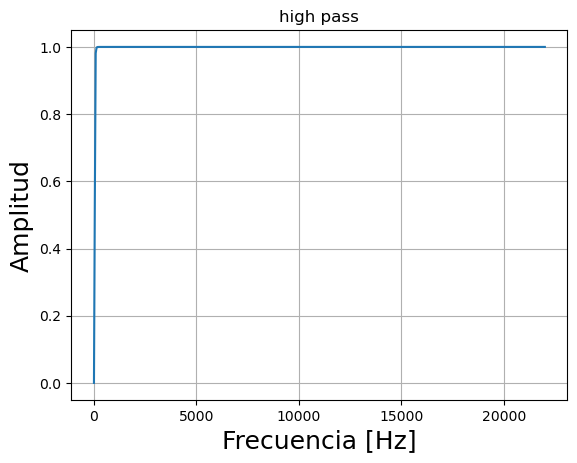

In [62]:
#filtro IIR
fc1=100/fs
b, a = sp.butter(3, fc1 ,  btype='highpass', analog=False, output='ba', fs=None)
wb, Hb = sp.freqz(b, a);

plt.plot((wb*fs)/(2*np.pi), np.abs(Hb))
plt.title('high pass')
plt.ylabel('Amplitud', fontsize=18)
plt.xlabel('Frecuencia [Hz]', fontsize=18)
plt.grid()
plt.show()

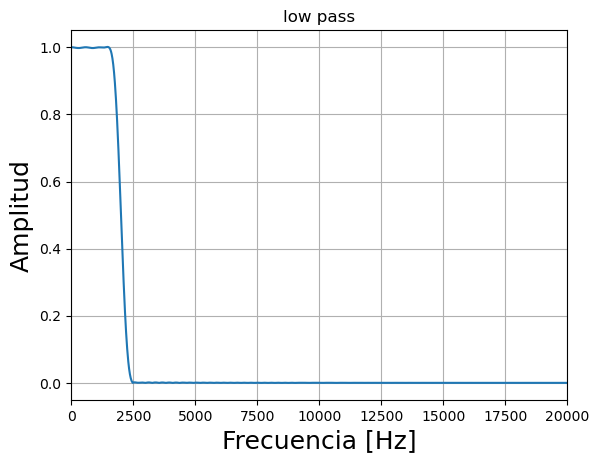

In [61]:
#filtro FIR
nyq_rate = fs / 2.0
roll_off = 1000.0
cutoff_hz = 2000/nyq_rate
width = roll_off/nyq_rate
ripple_db = 60.0 #The desired attenuation in the stop band, in dB.
N, _= kaiserord(ripple_db, width) # Compute the order and Kaiser parameter for the FIR filter.
taps = firwin(N,cutoff_hz, pass_zero='lowpass')
w, h = signal.freqz(taps, [1], worN=2000)
plt.plot(nyq_rate*w/np.pi, np.abs(h))
plt.xlim([0, 20000])
plt.title('low pass')
plt.ylabel('Amplitud', fontsize=18)
plt.xlabel('Frecuencia [Hz]', fontsize=18)
plt.grid()
plt.show()

Responda:
¿Porqué eligió el filtro IIR de esa tipología, su frecuencia de corte y su orden?

se escogio el butterworth para evitar ripple en la banda de paso y tener una transicion suave sobre la frecuencia de corte. Se hizo uso de esa frecuencia de corte aprovechando la informacion obtenida (de la creacion del audio con efecto). Se escogió tambié ese orden, ya que nos permite realizar la transicion suave que inicialmente buscabamos con el buttterworth.


para el caso del filtro FIR ¿Por qué eligió ese roll-off, frecuencia de corte y nivel de ripple?

El valor del roll-off se escogió porque en el espectrograma se puede visualizar que hay energia en frecuencias superiores a 2kHz en menor nivel. La fc se puede visualizar facilmente tanto en el espectrograma como en la fft, entonces se escogió porque era un dato que aunque inicialmente se tenía, se pudo corroborar en el proceso de realizacion de esta guia. El nivel de ripple se escogió porque en la fft se nota un cambio en el nivel de energa en las frecuencias de banda de paso de la señal con efecto.

## 4.2 Aplicación de Filtros

Usted debe aplicar los filtros diseñados para obtener la respuesta que permita el efecto walkie – talkie. Si lo desea, escuche la señal las veces necesarias para llevar un control de los efectos de los filtros y devuélvase a paso anterior si es necesario. 

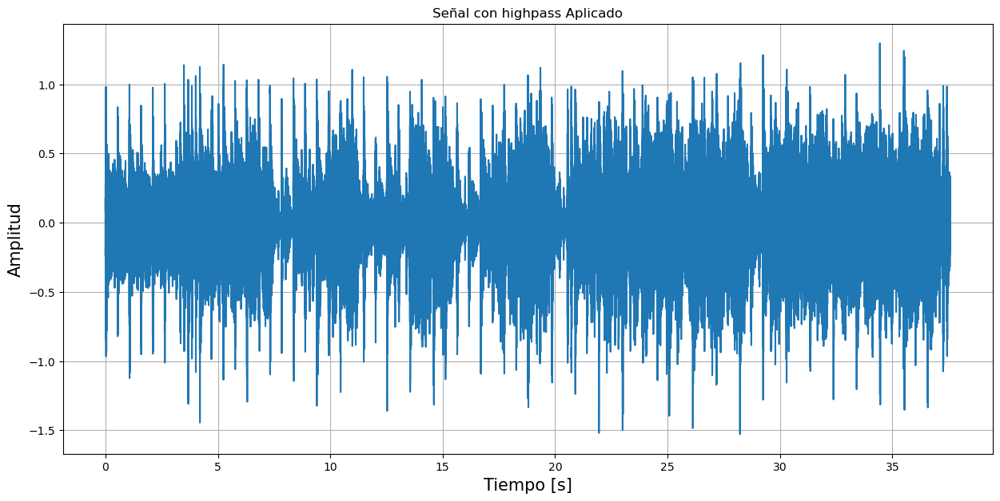

In [68]:
#Aplicación de filtro pasa altas FIR
highpass=sp.lfilter(b, a, x1)
plt.figure(figsize=(15,7))
plt.plot(t,highpass)
plt.title('Señal con highpass Aplicado')
plt.xlabel('Tiempo [s]',fontsize=15)
plt.ylabel('Amplitud',fontsize=15)
plt.grid()
plt.show()

Audio(highpass,rate=fs)

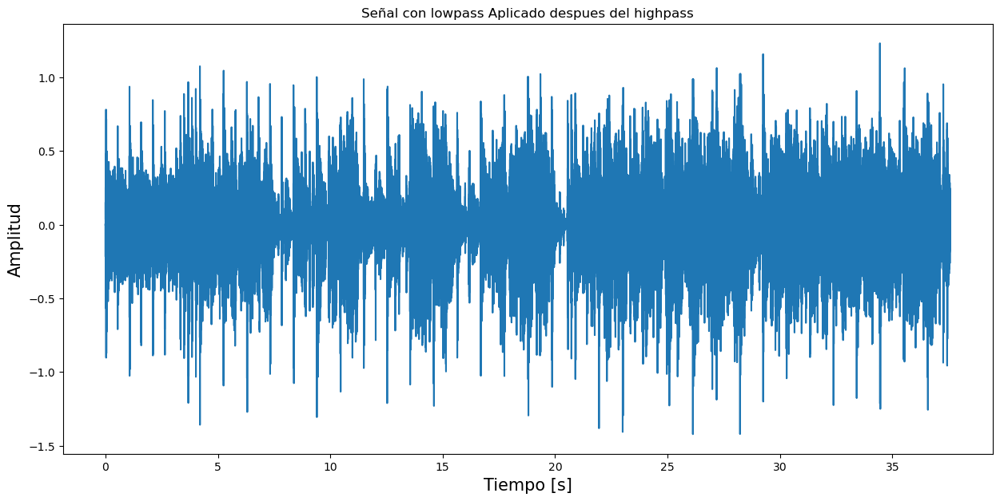

In [67]:
#Aplicación de pasa bajos IIR
filtered_x = lfilter(taps, 1.0, highpass)
plt.figure(figsize=(15,7))
plt.plot(t,filtered_x)  #graficacion
plt.title('Señal con lowpass Aplicado despues del highpass')
plt.xlabel('Tiempo [s]',fontsize=15)
plt.ylabel('Amplitud',fontsize=15)
plt.show()
Audio(filtered_x,rate=fs)  #para escuchar la señal si se desea

## 4.3 Análisis del efecto conseguido

En esta sección usted deberá aplicar el análisis en frecuencia ya realizado con anterioridad (ftt, espectrograma), pero a la señal con el efecto que ha diseñado.

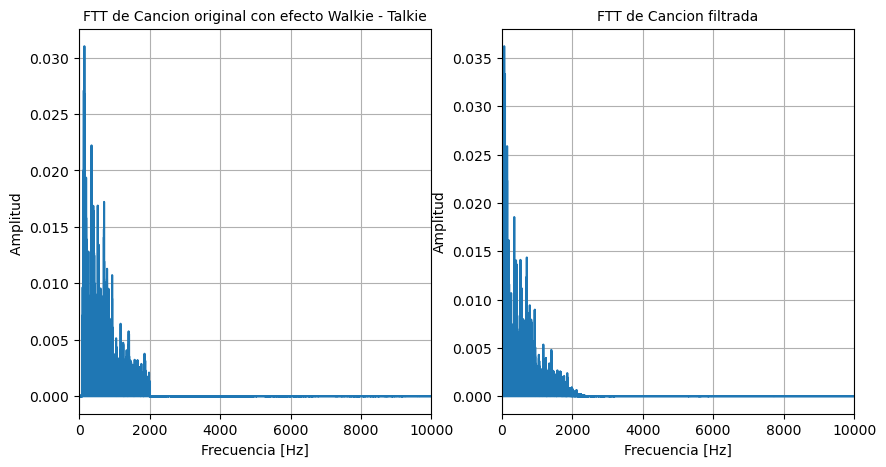

In [53]:
fft_1 = fft(x2)#fft de la cancion con efecto walkie talkie
xf = fftfreq(fft_1.size, 1/fs) 

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.plot(xf, abs(fft_1)/np.linalg.norm(fft_1))
plt.xlim(0,10000)
plt.xlabel('Frecuencia [Hz]',fontsize=10)
plt.ylabel('Amplitud ',fontsize=10)
plt.title('FTT de Cancion original con efecto Walkie - Talkie',fontsize=10)
plt.grid()


fft_2 = fft(filtered_x)#fft de la cancion con efecto diseñado
xf = fftfreq(fft_2.size, 1/fs2) 

plt.subplot(1,2,2)
plt.plot(xf, abs(fft_2)/np.linalg.norm(fft_2))
plt.xlim(0,10000)
plt.xlabel('Frecuencia [Hz]',fontsize=10)
plt.ylabel('Amplitud',fontsize=10)
plt.title('FTT de Cancion filtrada',fontsize=10)
plt.grid()

plt.show()

Responda:
¿Que puede decir acerca de las graficas FFT obtenidas? 

Se obtiene un comportamiento muy parecido entre ambas señales. No son completamente identicas, debido a que no se conocen muchos datos de los filtros aplicados a la señal con efecto inicial, por lo tanto se trata de hacer un acercamiento a dicho efecto.

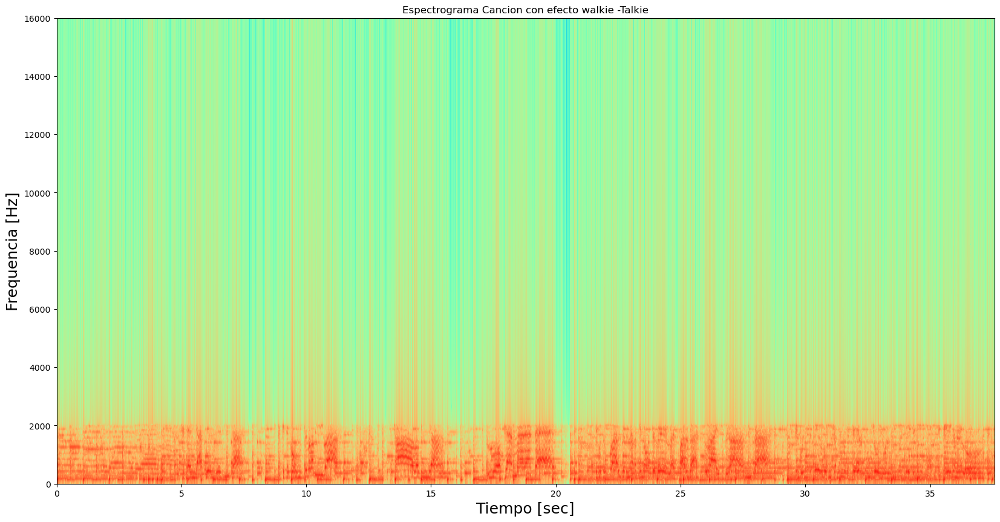

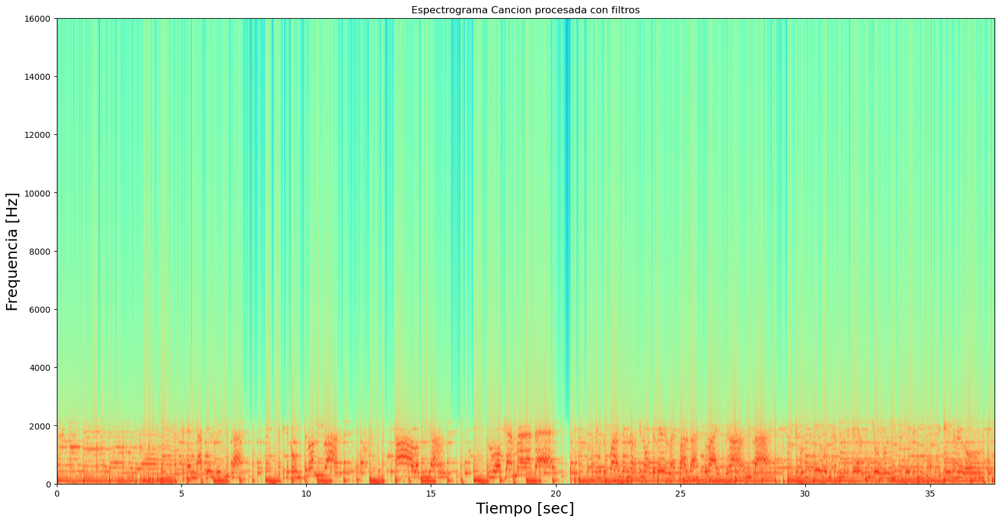

In [65]:
size=0.050
#Espectrograma de cancion con efecto
ventanas=extraer_ventanas(x2,int(size*fs),fs)
window=np.blackman(len(ventanas[0]))
v_blackman=window*ventanas

espectro,nfft=potspec(v_blackman,int(0.050*fs),1024)

espectro=np.flipud(10*np.log10(espectro).T)
plt.figure(figsize=(20,10))
plt.title('Espectrograma Cancion con efecto walkie -Talkie')
plt.imshow(espectro,aspect='auto', cmap="rainbow",extent=[0, len(x1)/fs, 0, fs//2])
plt.ylim(0,16000)
plt.ylabel('Frequencia [Hz]', fontsize=18)
plt.xlabel('Tiempo [sec]', fontsize=18)
plt.show()

#Espectrograma de cancion procesada con filtro
ventanas=extraer_ventanas(filtered_x,int(size*fs),fs)
window=np.blackman(len(ventanas[0]))
v_blackman=window*ventanas

espectro,nfft=potspec(v_blackman,int(0.050*fs),1024)

espectro=np.flipud(10*np.log10(espectro).T)
plt.figure(figsize=(20,10))
plt.title('Espectrograma Cancion procesada con filtros')
plt.imshow(espectro,aspect='auto', cmap="rainbow",extent=[0, len(filtered_x)/fs, 0, fs//2])
plt.ylim(0,16000)
plt.ylabel('Frequencia [Hz]', fontsize=18)
plt.xlabel('Tiempo [sec]', fontsize=18)
plt.show()

Responda:

 ¿Que se puede decir de ambos espectrogramas? 
 
 se puede visualizar que en el filtrado realizado hay una disminucion en mayor medida la energia de frecuencia por encima de los 2kHz, a diferencia de la señal inicial con efecto.
 
 ¿A partir de los graficos se puede concluir que se logró el efecto deseado? 
 
 si, hay una aproximacion bastante fiel a la respuesta en frecuencia de la señal con efecto que se tiene inicialmente.

## Punto extra

Repita el proceso del espectrograma haciendo uso de una Ventana Tipo Tukey:
1. Visualice la respuesta en frecuencia de la Ventana, use la librería scipy y matplotlib para ello
3. Aplique al espectrograma y visualice


C:\Users\Usuario\AppData\Local\Temp\ipykernel_4024\4271489970.py:6: RuntimeWarning: divide by zero encountered in log10
  response = 20 * np.log10(np.abs(fftshift(A / abs(A).max())))


Text(0.5, 0, 'Frecuencia normalizada [ciclos por muestra]')

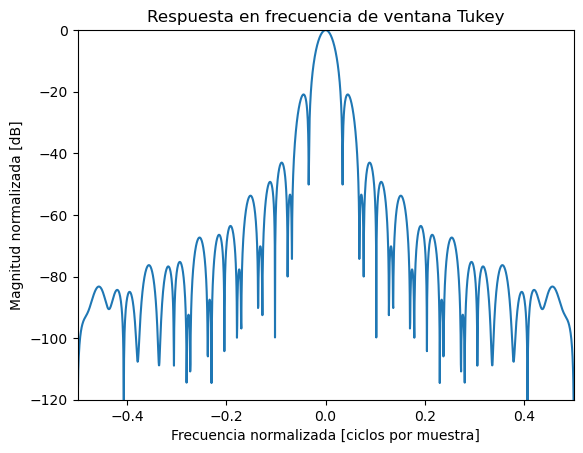

In [66]:
window = signal.windows.tukey(50, alpha=0.8, sym=True)

plt.figure()
A = fft(window, 2048) / (len(window)/2.0)
freq = np.linspace(-0.5, 0.5, len(A))
response = 20 * np.log10(np.abs(fftshift(A / abs(A).max())))
plt.plot(freq, response)
plt.axis([-0.5, 0.5, -120, 0])
plt.title("Respuesta en frecuencia de ventana Tukey")
plt.ylabel("Magnitud normalizada [dB]")
plt.xlabel("Frecuencia normalizada [ciclos por muestra]")


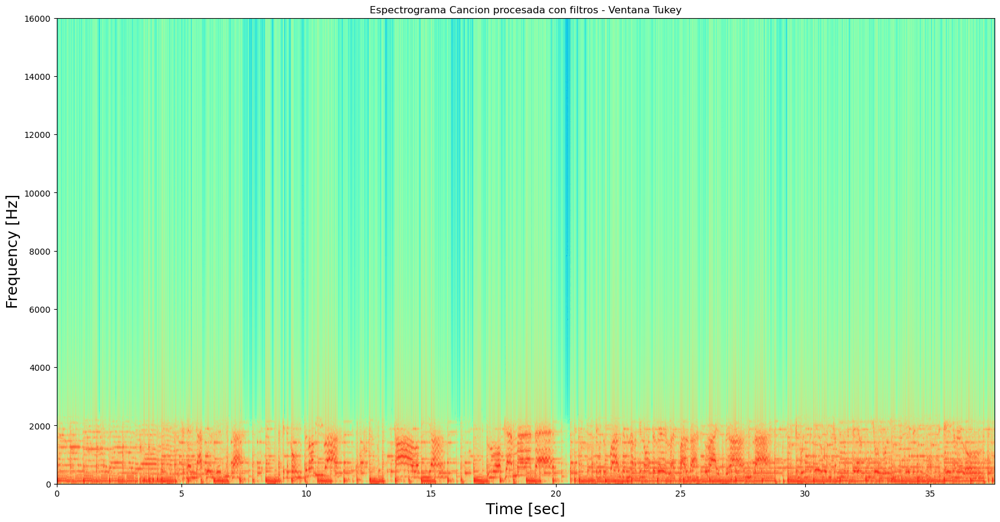

In [56]:
ventanas=extraer_ventanas(filtered_x,int(size*fs),fs)
window = signal.windows.tukey(len(ventanas[0]), alpha=0.8, sym=True)
v_hamming=window*ventanas

espectro,nfft=potspec(v_hamming,int(0.050*fs),1024)

espectro=np.flipud(10*np.log10(espectro).T)
plt.figure(figsize=(20,10))
plt.title('Espectrograma Cancion procesada con filtros - Ventana Tukey')
plt.imshow(espectro,aspect='auto', cmap="rainbow",extent=[0, len(filtered_x)/fs, 0, fs//2])
plt.ylim(0,16000)
plt.ylabel('Frequency [Hz]', fontsize=18)
plt.xlabel('Time [sec]', fontsize=18)
plt.show()

Responda:

 ¿Qué ventajas tiene el uso de la ventana Tukey?
 
 La mayor ventaja es que se puede modificar el parametro alpha, el cual permite sin cambiar de ventana, modificar la respuesta esperada; por ejemplo: con un alpha=0 se comporta igual a una ventana rectanglar, y con un alpha=1 se comporta como una hanning.
 
 ¿Que diferencia encuentra en el espectrograma con la ventana tukey, en comparacion a la ventana utilizada con anterioridad (blackman)? 
 
 Se puede visualizar mas nitidamente la seccion de la banda de paso y se reduce la visualizacion de frecuencias que no se encuentran dentro de esta banda.

## 5. Comparacion de audios

Compare tanto la señal de audio con efecto walkie-Talkie, como la señal procesada con el mismo efecto. (para ello debe escuchar ambas señales y en caso de desearlo, graficarlas).

In [57]:
print('Cancion con efecto Walkie - Talkie')
Audio(x2,rate=fs2)

Cancion con efecto Walkie - Talkie


In [58]:
print('Cancion filtrada con efecto Walkie - Talkie')
Audio(filtered_x,rate=fs)

Cancion filtrada con efecto Walkie - Talkie


Responda:

 ¿Se consiguió el efecto deseado auditivamente? 
 si se consiguió, aunque no de una manera exacta. De igual manera se puede decir que es una aproximacion acertada.

# 6.Conclusiones

-El uso de filtros aplicados a la musica, puede ser un buen recurso para personas que desean explorar con diferentes efectos sin recurrir a programas exteriores.

-La correcta eleccion de una ventana, puede influir en la visualizacion de las componentes frecuenciales cuando se representa una señal en un espectrograma o en el grafico de una fft.

-la fft es una herramienta util para conocer el comportamiento frecuencial de una señal que ha sido procesada o modificada.

-En los filtros IIR no es recomendable hacer uso de un orden muy grande, ya que esto puede representar un mayor nivel de ripple en la banda de paso.

-Los filtros FIR permiten el control sobre el ancho de banda de transicion y el nivel de ripple deseado dentro del diseño de un filtro, lo cual hace que el filtro diseñado se adapte mejor a las necesidades específicas del filtrado.